In [1]:
import scanpy as sc
import pandas as pd
from pathlib import Path
import anndata as ad
import numpy as np

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

DPI = 300
FONTSIZE = 20  # 42

sc.settings.set_figure_params(
    scanpy=True, dpi=100, transparent=True, vector_friendly=True, dpi_save=DPI
)
from matplotlib import rcParams

rcParams["pdf.fonttype"] = 42

In [2]:
DIR2SAVE = Path(
    "/data/BCI-CRC/nasrine/data/CRC/Metastatic_CRC_LM_dataset/annotation_global/"
)
DIR2SAVE.mkdir(parents=True, exist_ok=True)

In [3]:
FIG2SAVE = DIR2SAVE.joinpath("figures/")
FIG2SAVE.mkdir(parents=True, exist_ok=True)
# set the global variable: sc.settings.figdir to save all plots
sc.settings.figdir = FIG2SAVE

In [4]:
adata_liver = sc.read_h5ad(
    "/data/BCI-CRC/nasrine/data/CRC/Metastatic_CRC_LM_dataset/data_integration/Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg.h5ad"
)
adata_liver.shape

(107428, 2000)

In [5]:
adata_liver.obs.cell_source.value_counts()

Wu-Cells      53129
Che-Cells     48954
BCI-Nuclei     5345
Name: cell_source, dtype: int64

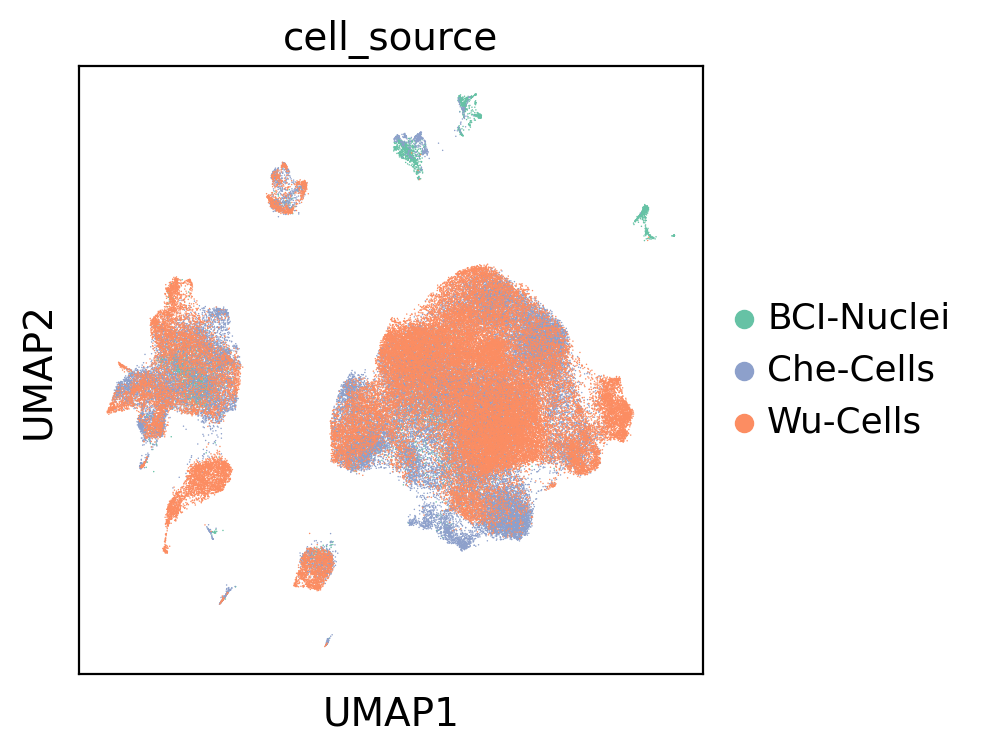

In [6]:
sc.pl.umap(adata_liver, color="cell_source", show=True)

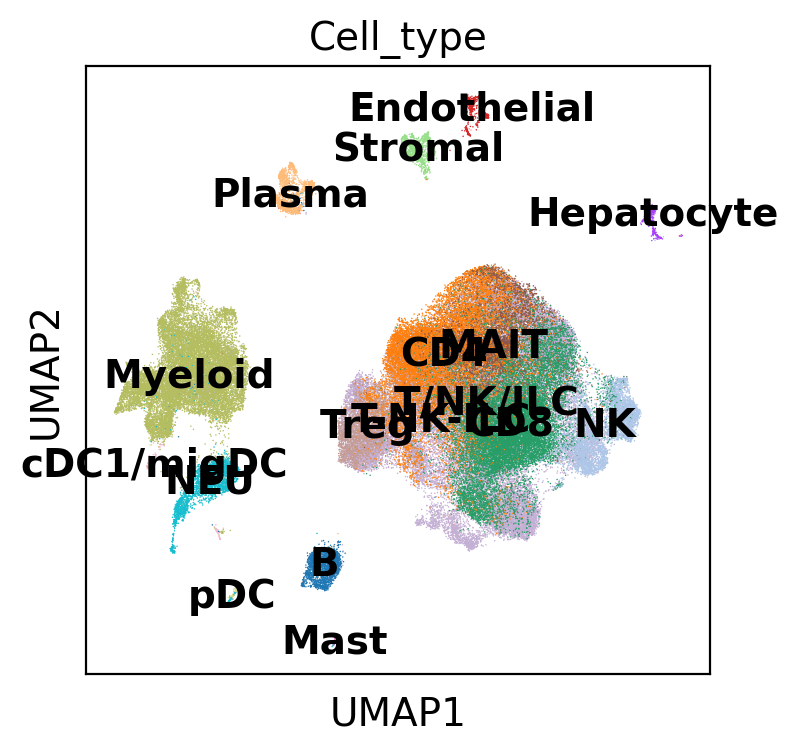

In [7]:
sc.pl.umap(adata_liver, color="Cell_type", legend_loc="on data")

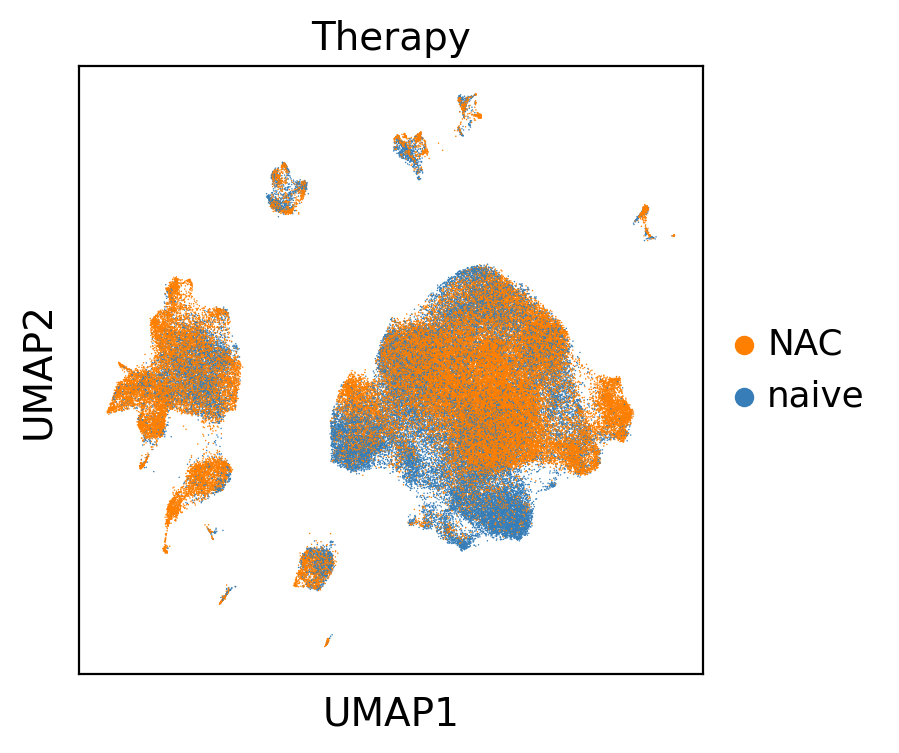

In [8]:
sc.pl.umap(adata_liver, color="Therapy", show=True)

### Leiden clustering

In [9]:
adata_liver.uns["neighbors"]

OverloadedDict, wrapping:
	{'connectivities_key': 'connectivities', 'distances_key': 'distances', 'params': {'method': 'umap', 'metric': 'euclidean', 'n_neighbors': 15, 'n_pcs': 10, 'random_state': 7, 'use_rep': 'X_scVI'}}
With overloaded keys:
	['connectivities', 'distances'].

In [10]:
from collections import Counter


def clustering_leiden_resolution(adata2test, res_range):
    """
    Performs hyperparameter search for resolution in leiden clustering
    :param adata2test: AnnData frame
    :param res_range: range of values to evaluate: i.e. np.arange(0.1, 1.5, 0.05)
    """
    resolution_dict = {r: None for r in res_range}
    # vary resolution parameter and see which nb of clusters occurs more frequently
    for r in res_range:
        # load adata
        adata = adata2test.copy()
        sc.tl.leiden(adata, resolution=r, random_state=7)
        # store nb of clusters for that resolution
        resolution_dict[r] = len(set(adata.obs["leiden"]))

    # plot figure: nb clusters in fct of resolution param
    fig, ax = plt.subplots(
        nrows=1, ncols=1, sharey=False, sharex=False, dpi=DPI, figsize=(5, 4.5)
    )
    plt.scatter(resolution_dict.keys(), resolution_dict.values())
    ax.set_xlabel("Resolution")
    ax.set_ylabel("Number of clusters")
    ax.tick_params(axis="both", which="major", labelsize=FONTSIZE - 10)
    plt.show()

    # display nb of times each number of clusters occurs
    print("Frequency of NB clusters")
    print(Counter(list(resolution_dict.values())))

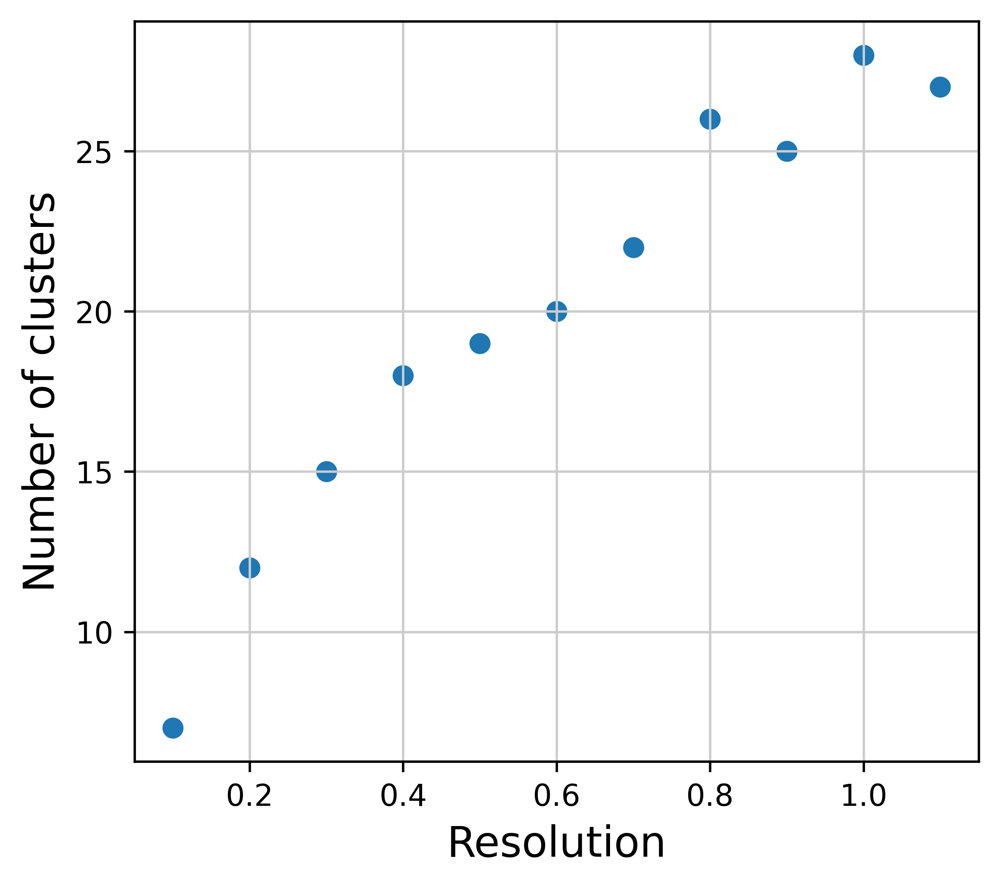

Frequency of NB clusters
Counter({7: 1, 12: 1, 15: 1, 18: 1, 19: 1, 20: 1, 22: 1, 26: 1, 25: 1, 28: 1, 27: 1})


In [11]:
clustering_leiden_resolution(adata_liver, res_range=np.arange(0.1, 1.2, 0.1))

In [12]:
# neighbors were already computed using scVI, so we perform clustering on that graph
sc.tl.leiden(adata_liver, key_added="leiden_scVI", resolution=0.2, random_state=7)

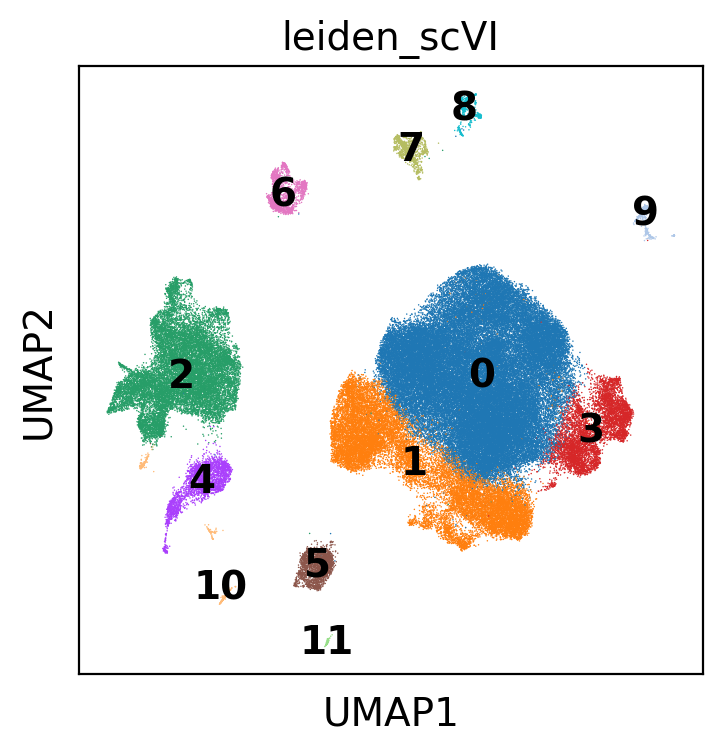

In [13]:
sc.pl.umap(
    adata_liver,
    color="leiden_scVI",
    legend_loc="on data",
    save="general_clustering.pdf",
    show=True,
)

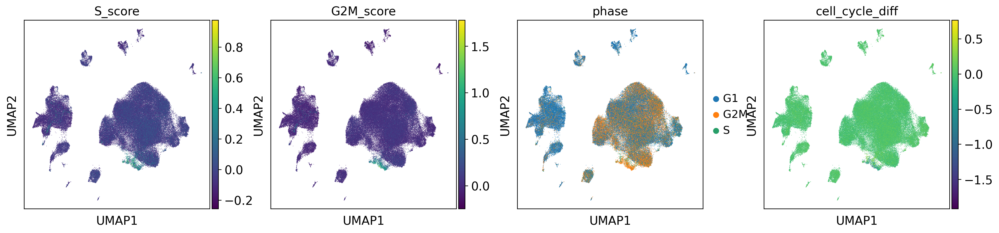

In [14]:
sc.pl.umap(adata_liver, color=["S_score", "G2M_score", "phase", "cell_cycle_diff"])

### Plot some markers 

In [5]:
markers = {
    "Epithelial": ["EPCAM", "CDH1"],
    "Myeloid": ["CD68", "CD14"],
    "Kupffer": ["SLC11A1", "CD5L", "TIMD4", "CETP"],
    "Granulocyte": ["CPA3", "GATA2", "TPSAB1"],
    "Neutrophil": [
        "FCGR3B",
        "S100A8",
        "S100A12",
        "MPO",
        "ELANE",
        "DEFA4",
        "DEFA3",
        "CEACAM6",
    ],
    "Stromal": ["DCN", "VCAM1", "COL1A1", "COL3A1"],
    "Endothelial": ["PECAM1", "CDH5", "LYVE1"],
    "T/NK/ILC": ["TRAC", "CD3D", "CD3E", "CD3G", "KLRB1", "GZMB"],
    "NK": ["EOMES", "CMC1", "GZMK", "XCL1", "NKG7", "PRF1", "NCR1", "NCAM1", "FCER1G"],
    "ILC": ["AREG", "TLE1", "IL4I1"],
    "Mast": ["KIT", "TPSAB1", "TPSB2", "MS4A2"],
    "B": ["CD79A", "MS4A1"],
    "Plasma B": ["SDC1", "MZB1"],
    "Hepatocyte": ["ALB", "TTR", "APOA1", "AFP"],
    "Cholangiocyte": ["SOX9", "EPCAM", "KRT19", "CLDN4", "CLDN10", "FXYD2"],
    "DC": ["FCER1A", "PKIB", "CD1C", "PCLAF", "CLEC10A", "CES1"],
}

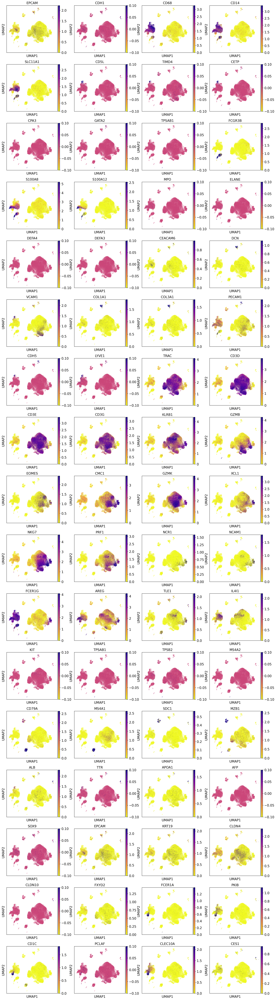

In [6]:
import itertools

# use log1p data stored in .raw
markers2plot = list(
    itertools.chain(*list(markers.values()))
)  # get all markers in a single list
sc.pl.umap(
    adata_liver,
    color=markers2plot,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",  #'RdPu',
    save="general_markers.pdf",
    show=True,
)

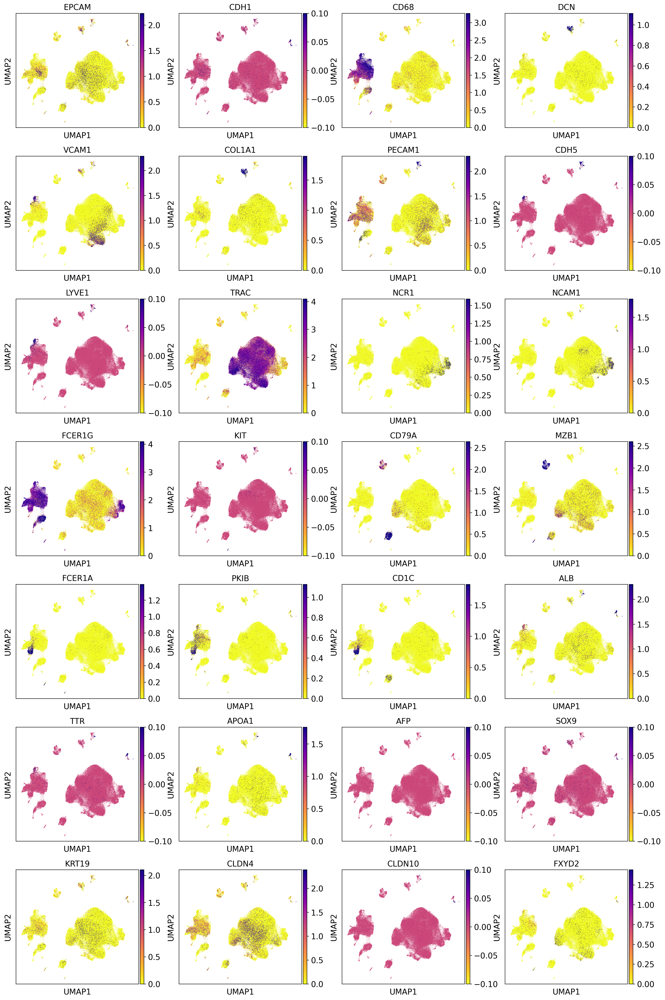

In [7]:
marker_subset = [
    "EPCAM",
    "CDH1",
    "CD68",
    "DCN",
    "VCAM1",
    "COL1A1",
    "PECAM1",
    "CDH5",
    "LYVE1",
    "TRAC",
    "NCR1",
    "NCAM1",
    "FCER1G",
    "KIT",
    "CD79A",
    "MZB1",
    "FCER1A",
    "PKIB",
    "CD1C",
    "ALB",
    "TTR",
    "APOA1",
    "AFP",
    "SOX9",
    "KRT19",
    "CLDN4",
    "CLDN10",
    "FXYD2",
]
sc.pl.umap(
    adata_liver,
    color=marker_subset,
    use_raw=True,
    vmin=0.0,
    vmax="p99",
    color_map="plasma_r",
    save="general_markers_major_celltypes.pdf",
    show=True,
)

In [17]:
adata_liver

AnnData object with n_obs × n_vars = 107428 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 'cell_source', '_scvi_batch', '_scvi_labels', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'leiden_scVI'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Cell_type_colors', 'Therapy_colors', 'Tissue_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_source_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap', 'leiden', 'leiden_scVI_colors', 'phase_colors'
    obsm: 'X_pca', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    varm: 'PCs'
    layers: 'log1p', 'normalised', 'raw', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

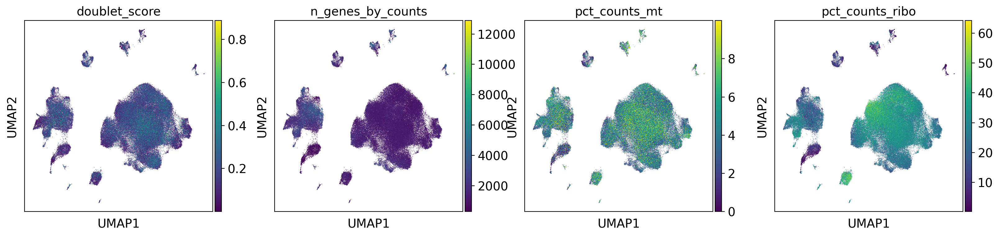

In [18]:
sc.pl.umap(
    adata_liver,
    color=["doublet_score", "n_genes_by_counts", "pct_counts_mt", "pct_counts_ribo"],
    color_map="viridis",
    save="QC_covariates.pdf",
)

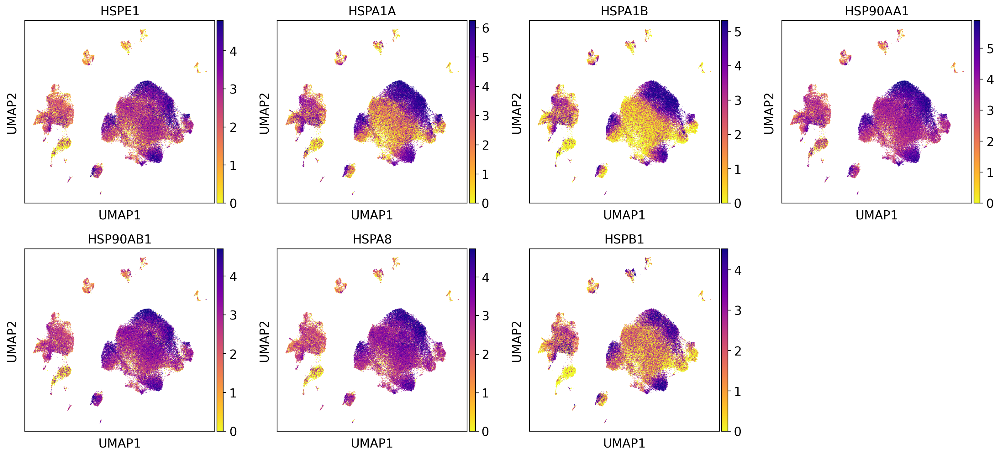

In [8]:
### markers for stress
# HSP
dissocation_markers_dict = {
    "shock protein": [
        "HSPE1",
        "HSPA1A",
        "HSPA1B",
        "HSP90AA1",
        "HSP90AB1",
        "HSPA8",
        "HSPB1",
    ],
    "immediate early genes": ["FOS", "JUN"],
}

sc.pl.umap(
    adata_liver,
    color=dissocation_markers_dict["shock protein"],
    vmax="p99",
    use_raw=True,
    vmin=0,
    color_map="plasma_r",
    save="general_HSPmarkers.pdf",
    show=True,
)

### Differential expression to get DE genes upregulated per cluster 

In [20]:
# issue here https://github.com/theislab/single-cell-tutorial/issues/97
# This seems to be a scanpy bug as you can see here and here. The latter issue suggests to just add the line:
# adata.uns['log1p']["base"] = None after reading again, or downgrading to AnnData<0.8.
# Either way, this should be fixed soon by the maintenance team.
adata_liver.uns["log1p"]["base"] = None

In [22]:
sc.tl.rank_genes_groups(
    adata_liver,
    groupby="leiden_scVI",
    reference="rest",
    method="wilcoxon",
    use_raw=True,
    layer=None,
    pts=True,
    corr_method="benjamini-hochberg",
    key_added="rank_genes_wilcoxon",
)

categories: 0, 1, 2, etc.
var_group_labels: Epithelial, Myeloid, Kupffer, etc.


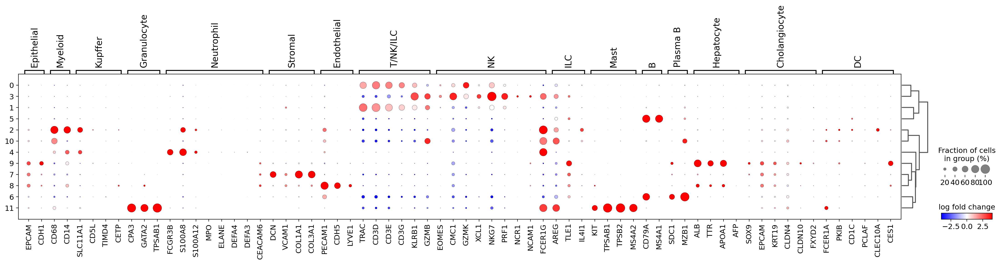

In [23]:
sc.pl.rank_genes_groups_dotplot(
    adata_liver,
    groupby="leiden_scVI",
    key="rank_genes_wilcoxon",
    var_names=markers,
    values_to_plot="logfoldchanges",
    cmap="bwr",
    vmin=-4,
    vmax=4,
    min_logfoldchange=1,
    colorbar_title="log fold change",
    save="general_dotplot.pdf",
    show=True,
)

In [24]:
adata_liver

AnnData object with n_obs × n_vars = 107428 × 2000
    obs: 'Patient', 'Sample', 'Cell_type', 'Cell_subtype', 'Tissue', 'Therapy', 'doublet_score', 'n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo', 'cell_source', '_scvi_batch', '_scvi_labels', 'S_score', 'G2M_score', 'phase', 'cell_cycle_diff', 'leiden_scVI'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'Cell_type_colors', 'Therapy_colors', 'Tissue_colors', '_scvi_manager_uuid', '_scvi_uuid', 'cell_source_colors', 'hvg', 'log1p', 'neighbors', 'pca', 'umap', 'leiden', 'leiden_scVI_colors', 'phase_colors', 'rank_genes_wilcoxon', 'dendrogram_leiden_scVI'
    obsm: 'X_pca', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    varm: 'PCs'
    layers: 'log1p', 'normalised', 'raw', 'scvi_normalized'
    obsp: 'connectivities', 'distances'

### Cell annotation

In [25]:
old_to_new = {
    "0": "T-NK-ILC",
    "1": "T-NK-ILC",
    "2": "Myeloid",
    "3": "T-NK-ILC",
    "4": "Myeloid",
    "5": "B",
    "6": "Plasma",
    "7": "Stromal",
    "8": "Endothelial",
    "9": "Hepatocyte",
    "10": "Myeloid",
    "11": "Mast",
}

In [26]:
adata_liver.obs["Annotation_scVI"] = (
    adata_liver.obs["leiden_scVI"].map(old_to_new).astype("category")
)

### Set colours for cell types 

`
'Epithelial': '#fdb462'
'T-NK-ILC': '#f768a1' not #'#fccde5'
'Myeloid': '#80b1d3'
'Mast:'#969696'
'Stromal': '#b3de69'
'Endothelial': '#8dd3c7'
'B': '#bc80bd'
'Plasma': '#bebada'
'Hepatocyte':'#fb8072'
'Cholangiocyte': '#ccebc5`

In [5]:
# set colours for cell types, need to know order
adata_liver.obs.Annotation_scVI.cat.categories.values.tolist()

['B',
 'Endothelial',
 'Hepatocyte',
 'Mast',
 'Myeloid',
 'Plasma',
 'Stromal',
 'T-NK-ILC']

In [6]:
pal_dict = {"B": "#BEBADA",
            "Endothelial": "#8DD3C7",
            "Epithelial": "#FB8072",#E41A1C #FB8072
            "Hepatocyte": "#FDB462",
            "Mast": "#fccde5", #"#000000",
            "Myeloid": "#80B1D3",
            "Plasma": "#7570B3",#B3B3B3
            "Stromal": "#B3DE69",
            "T-NK-ILC": "#F781BF"
           } 

In [7]:
# same order as categories
adata_liver.uns["Annotation_scVI_colors"] = [
    pal_dict["B"],
    pal_dict["Endothelial"],
    pal_dict["Hepatocyte"],
    pal_dict["Mast"],
    pal_dict["Myeloid"],
    pal_dict["Plasma"],
    pal_dict["Stromal"],
    pal_dict["T-NK-ILC"]
]

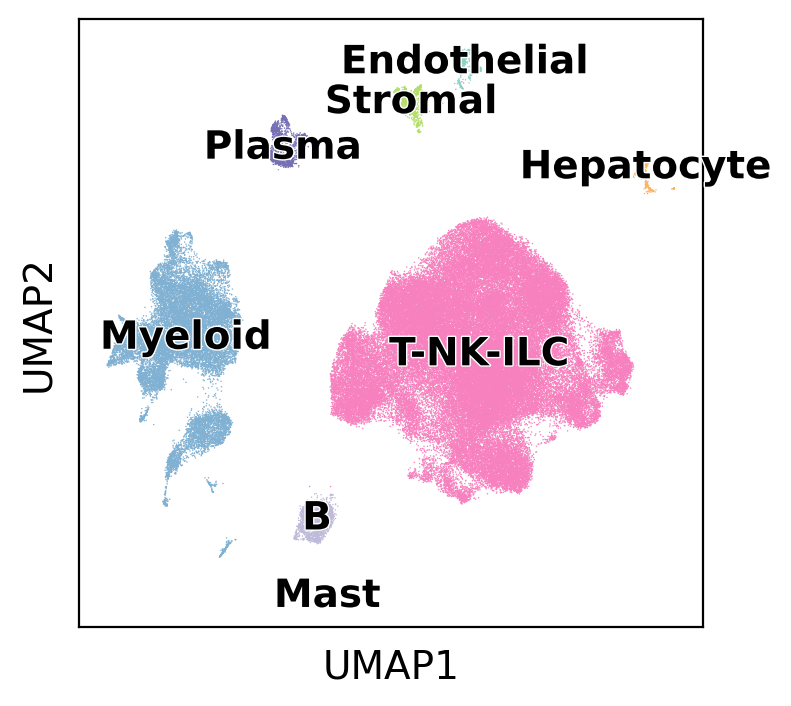

In [8]:
sc.pl.umap(
    adata_liver,
    color="Annotation_scVI",
    show=True,
    legend_loc="on data",
    legend_fontoutline=1,
    save="general_annotation.pdf",
    title="",
)

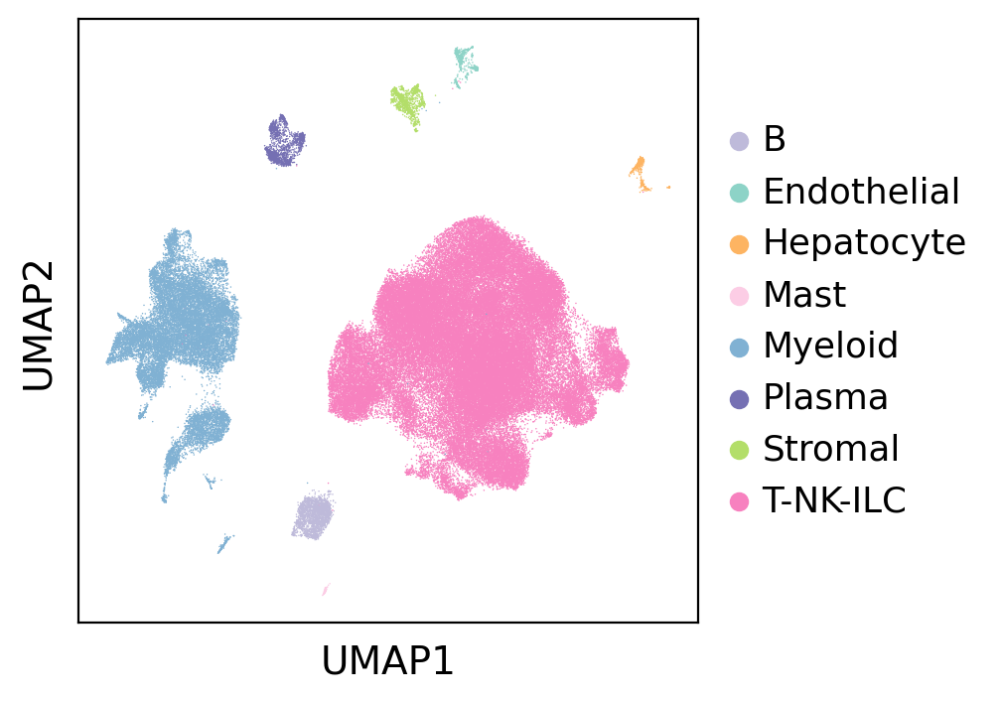

In [9]:
sc.pl.umap(
    adata_liver,
    color="Annotation_scVI",
    show=True,
    legend_loc="right margin",
    save="general_annotation_legend_side.pdf",
    title="",
)

In [10]:
# set colours for therapy
adata_liver.obs.Therapy.cat.categories

Index(['NAC', 'naive'], dtype='object')

In [11]:
adata_liver.uns["Therapy_colors"] = ["#ff7f00", "#377eb8"]

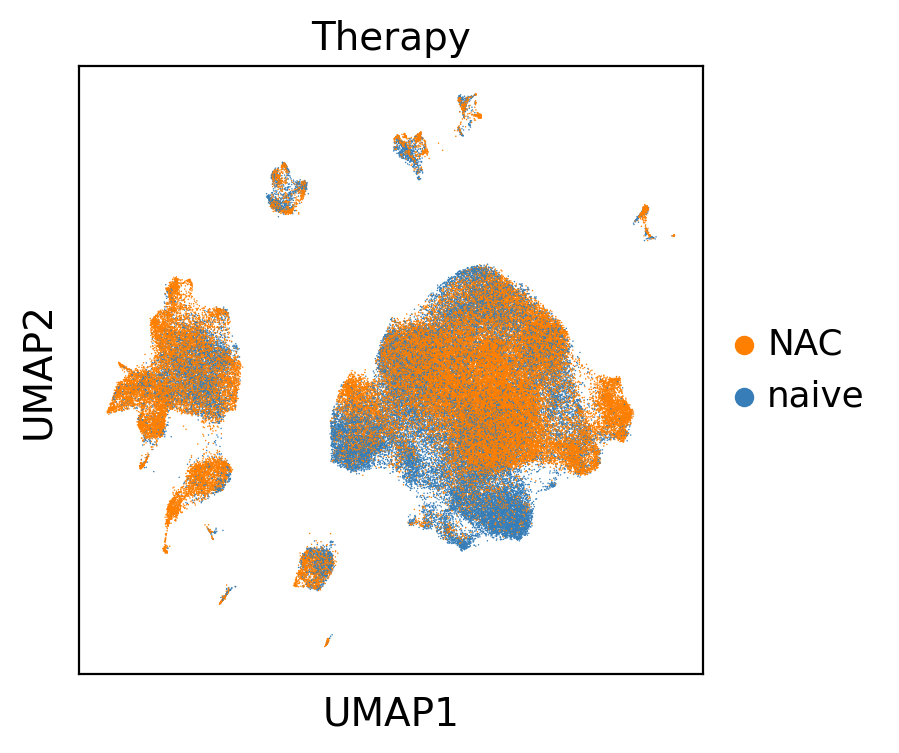

In [12]:
sc.pl.umap(adata_liver, color="Therapy", show=True)

### write to file

In [13]:
# write to file
adata_liver.write(
    DIR2SAVE.joinpath("Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_clustering.h5ad")
)

# write csv of annotations
adata_liver.obs["Annotation_scVI"].to_csv(
    DIR2SAVE.joinpath(
        "Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_annotations_general.txt"
    ),
    sep="\t",
    index=True,
    header=True,
)

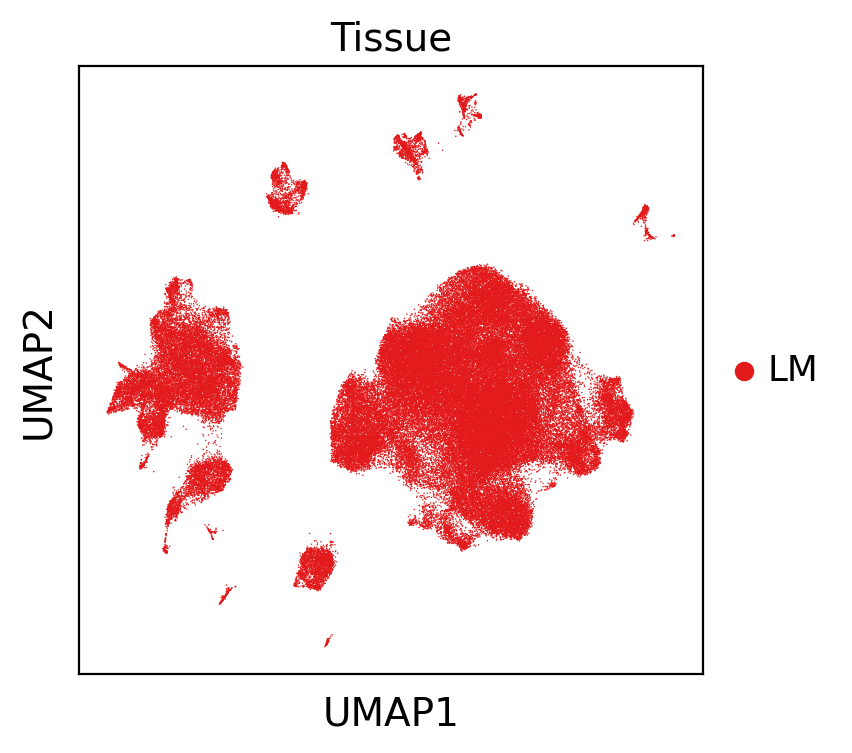

In [14]:
sc.pl.umap(adata_liver, color="Tissue", show=True)

In [15]:
adata_liver.uns["Tissue_colors"]

array(['#e31a1c'], dtype=object)

### plot proportion per cell type

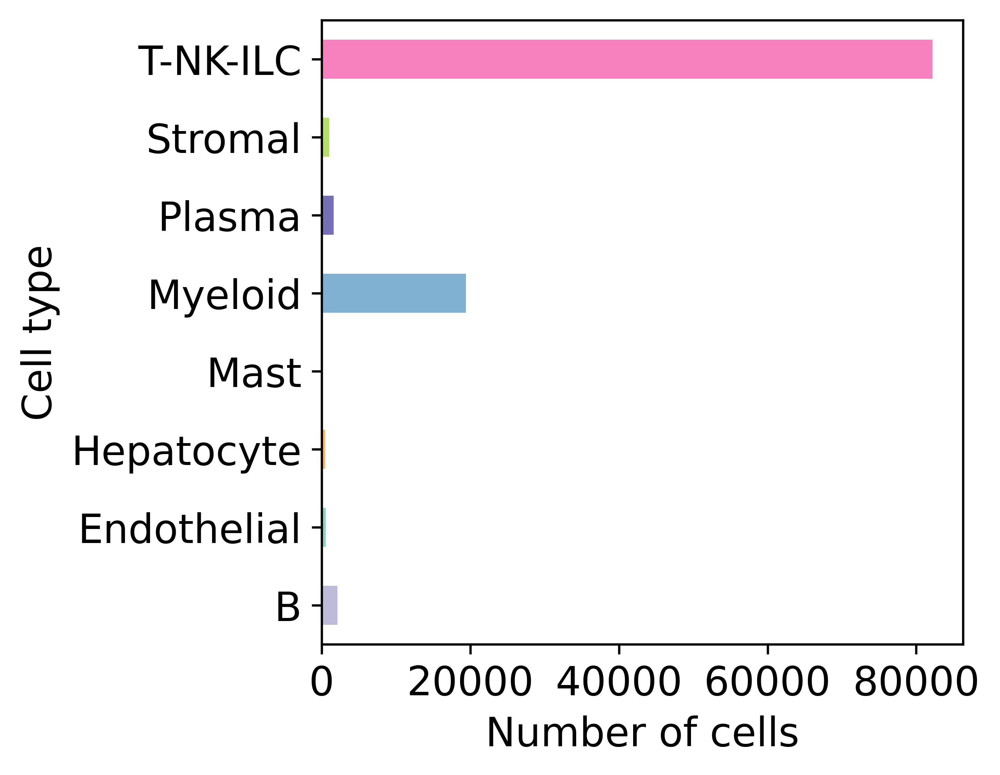

In [16]:
from collections import OrderedDict

color_dict = OrderedDict(
    zip(
        adata_liver.obs["Annotation_scVI"].cat.categories.values.tolist(),
        adata_liver.uns["Annotation_scVI_colors"],
    )
)

fig, ax = plt.subplots(nrows=1, ncols=1, sharey=False, sharex=False, dpi=DPI)
adata_liver.obs.groupby("Annotation_scVI").size().plot.barh(
    color=color_dict.values(), ax=ax
)
ax.set_ylabel("Cell type")
ax.set_xlabel("Number of cells")
ax.grid(False, which="major", axis="both")  # removes major horizontal gridlinesd
plt.savefig(FIG2SAVE.joinpath("barplot_nb_cells_celltype.pdf"))

In [4]:
adata_liver = sc.read_h5ad(
    DIR2SAVE.joinpath("Multiome_Che_Wu_CRC_LM_integrated_scvi_hvg_clustering.h5ad")
)
adata_liver.obs.Annotation_scVI.value_counts()

T-NK-ILC       82184
Myeloid        19398
B               2116
Plasma          1610
Stromal         1009
Endothelial      559
Hepatocyte       467
Mast              85
Name: Annotation_scVI, dtype: int64

In [5]:
adata_liver.obs[["Annotation_scVI", "cell_source"]].groupby(
    ["Annotation_scVI", "cell_source"]
).size()

Annotation_scVI  cell_source
B                BCI-Nuclei        98
                 Che-Cells        745
                 Wu-Cells        1273
Endothelial      BCI-Nuclei       490
                 Che-Cells         69
                 Wu-Cells           0
Hepatocyte       BCI-Nuclei       465
                 Che-Cells          1
                 Wu-Cells           1
Mast             BCI-Nuclei         1
                 Che-Cells         77
                 Wu-Cells           7
Myeloid          BCI-Nuclei      1911
                 Che-Cells       8272
                 Wu-Cells        9215
Plasma           BCI-Nuclei        64
                 Che-Cells        811
                 Wu-Cells         735
Stromal          BCI-Nuclei       671
                 Che-Cells        334
                 Wu-Cells           4
T-NK-ILC         BCI-Nuclei      1645
                 Che-Cells      38645
                 Wu-Cells       41894
dtype: int64